Where to Open Gas Stations in Turkey?
================
A Demographic Data Analysis, by Uğurhan Aksu

In [250]:
from bs4 import BeautifulSoup
import numpy as np
import os
import pandas as pd
import math
from scipy.optimize import minimize
import json
import geopy
from geopy.geocoders import Nominatim
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.cm as cm
import matplotlib.colors as colors
import requests
import folium
print("Import succesfull")

Import succesfull


## Table of Contents

1. Introduction
    * 1.1 Project Description
    * 1.2 Data Sources
2. Gathering Data
    * 2.1 Vehicle Data, Car Density
    * 2.2 Demographic Data, Population Data
    * 2.3 District Coordinates
    * 2.4 Gas Station Data
        * 2.4.1 FSQ API Credientals
        * 2.4.2 Querying FSQ for Gas Station Data
3. Formatting Data
    * 3.1 Removing Duplicate Records of Station Data
    * 3.2 Injecting New Information to Population Data
        * 3.2.1 Number of Gas Stations per District
        * 3.2.2 Number of Cars per Gas Station
    * 3.3 Relevant Data
4. Methodology
    * 4.1 Location Optimization
    * 4.2 Demographic Clustering of New Stations
    * 4.3 Evaluating Clusters
    * 4.4 Naming Clusters
    * 4.5 Mapping New Stations
5. Conclusion

## 1. Introduction

### 1.1 Project Description

There are over 12000 gas station facilites of more than 100 different companies are located over 81 provinces and 973 districts of Turkey. This project aims provide insights to a market penetrating company which currently has no presence in this market. Therefore any existing gas station facilities will be considered as rival facilities and best places to build new stations will be calculated. For this purpose, it will be the best to process traffic data but offical traffic data was not in a structured format and contained only highways and main roads. In order to cover the full country, best gas station locations are found by processing mostly population data. Optimal station locations in every district are believed to be found by maximizing the distance between facility to be built with rival facilities and at the same time minimizing the distance between facility to be built with population center. Since the new company is penetrating to the market, central fuel warehouses are not assumed to be present and logistic costs regarding deliveries are not considered in calculations. Results are then clustered with demographic data in order to express the findings with market insights.
    


### 1.2 Data Sources

##### 1.2.1 Demographic Data
    
Data regarding population parameters are obtained from TÜIK, Turkish National Statistic Provider. Since there aren't any publicly available data source provides population density within districts, it is assumed that population is accumulated in district centers. 2020 point data is used for analysis, population increase data field can also be used as average of recent past years in order to increase result clusters horizon.
    
File URL: https://data.tuik.gov.tr/Bulten/Index?p=Adrese-Dayali-Nufus-Kayit-Sistemi-Sonuclari-2020-37210, 

File Name: İl ve Cinsiyete Göre İl/İlçe Merkezi, Belde/ Köy Nüfusu ve Nüfus Yoğunluğu xls

##### 1.2.2 Vehicle Data
    
Population per car per district data are obtained from a local news agency, Hürriyet. After formatting, TÜİK population data is divided by this data source in order to find car density per district. It is assumed that car density within a province is homogenous. Data of 2018 is utilized.

##### 1.2.3 Coordination Data
Coordinates of every district center are found by passing adresses to geopy.geocoders package.

##### 1.2.4 Gas Station Data

Foursquare API is utilized for acquiring gas station coordinates. API is queried for maximum number of venues, maximum radius per district center in purpose of capturing all available gas stations. Districts that are closer than maximum available radius (100km) yielded overlapping results. In later steps, duplicate records are removed according to their proximity of different districts. Moreover, it is observed that some venue labels were improper (Gas stations labeled as restaurant, cafe etc.). Improper labels accounted for less than %0.01 therefore they are directly removed instead of correcting.


## 2. Gathering Data

### 2.1 Vehicle Data, Car Density

Html table is broken down into elements, relevant data is stored in a dataframe.

In [2]:
hurriyet_url = "https://www.hurriyet.com.tr/galeri-iste-il-il-kisi-basina-dusen-otomobil-sayisi-40916159/"
html_response = requests.get( hurriyet_url ).text

soup = BeautifulSoup( html_response, "lxml" )
prov_list = []
number_list = []
for class_row in list( soup.find_all("h3", {"class":"description"}) )[1::]:
    for indx in range(0, len(str(class_row).split('<h3 class="description">')[1].split( "<br/> <br/>" ))-1 ):
        class_element = str(class_row).split('<h3 class="description">')[1].split( "<br/> <br/>" )[indx]
        prov_list.append( class_element[:class_element.find( "kişiye bir otomobil düşüyor" )].split(":")[0] )
        number_list.append( class_element[:class_element.find( "kişiye bir otomobil düşüyor" )].split(":")[1][1:-1] )

#One of district was not available in the source
prov_list.append( "Muş" )
number_list.append( "12" )

car_density = pd.DataFrame({
    "Province":prov_list,
    "Number":number_list
})

#car_density.to_excel( os.path.expanduser("~/Desktop/IBM/9/") + "carDensity.xlsx")
car_density.head()

,Province,Number
0,Hakkari,131
1,Şırnak,123
2,Ağrı,53
3,Siirt,45
4,Bitlis,44


### 2.2 Demographic Data, Population Data

TÜİK data has to be downloaded in order to process. Provinces and districts are listed in same column hence they are seperated. Rural population in districts are shrinked and added to district center population in order to have a better assumption of population centers, rural_2center parameter can be tweaked within the script. Car population per district is estimated by using vehicle data.

In [3]:
rural_2center_ratio = 0.5

df_pop = pd.read_excel( ( os.path.expanduser("~/Desktop/IBM/9/") + "popDensity.xls" ),
                       skiprows = 7,
                       skipfooter = 8 )
df_pop.drop( columns="Unnamed: 4", axis=0, inplace=True )
col_names = ["District",
            "Total",
            "Center Population",
            "Rural Population",
            "Increase %"]
df_pop.columns =  col_names


# intergrating dfs
province_list = []
car_dens = []
for dist in list( df_pop["District"] ):
    if (dist in list( car_density["Province"] )) == True:
        temp_dist = dist
        temp_density = car_density[ car_density["Province"] == dist ]["Number"].values[0]
        province_list.append( temp_dist )
        car_dens.append( temp_density )
    else:
        province_list.append( temp_dist )
        car_dens.append( temp_density )

df_pop["Density"] = car_dens
df_pop["Province"] = province_list
df_pop["Density"] = df_pop["Density"].astype(int)

#eliminating provinces in district col
df_pop.drop( index=df_pop[ df_pop["District"] == df_pop["Province"] ].index.to_list(), inplace=True )
df_pop.reset_index(drop=True, inplace=True)

#eliminating nans in rural pop
df_pop["Rural Population"] = pd.to_numeric( df_pop["Rural Population"], errors="coerce")
df_pop["Rural Population"].fillna( value=0, inplace=True )

#Rural pop proportionally added to center pop
adjusted_pop = []
for i in range(0,df_pop.shape[0]):
    adjusted_pop.append( round(df_pop["Center Population"][i] + rural_2center_ratio*df_pop["Rural Population"][i])  )
df_pop["Adjusted Population"] = adjusted_pop


#estimating car population in centers
car_pop = []
for i in range(0,df_pop.shape[0]):
    car_pop.append( round(df_pop["Total"].iloc[i] / df_pop["Density"].iloc[i]) )
df_pop["Car Population"] = car_pop

df_pop.head()




,District,Total,Center Population,Rural Population,Increase %,Density,Province,Adjusted Population,Car Population
0,Aladağ,15998,15998,0.0,-7.659055,7,Adana,15998.0,2285.0
1,Ceyhan,161159,161159,0.0,1.129958,7,Adana,161159.0,23023.0
2,Çukurova,386634,386634,0.0,26.852669,7,Adana,386634.0,55233.0
3,Feke,16536,16536,0.0,-22.897428,7,Adana,16536.0,2362.0
4,İmamoğlu,27784,27784,0.0,-5.527454,7,Adana,27784.0,3969.0


### 2.3 District Coordinates
    

Text adress of districts are formed by using multiple fields of population dataframe as "District, Province, Country". Text and geolocator are used to obtain coordinates of every district. Coordinates are merged with population dataframe.

In [248]:
geolocator = Nominatim(user_agent="hannaksu@gmail.com")

lat = []
lon = []
not_found = []
print("Loading.", sep="", end="")
for i in range(0,df_pop.shape[0]):
    location = geolocator.geocode( df_pop.iloc[i,:]["District"]
                                  +", "+ df_pop.iloc[i,:]["Province"]
                                  +", "+ "Türkiye" )
    print(".", sep="", end="")
    if location != None:
        lat.append( location[-1][0] )
        lon.append( location[-1][1] )
    else:
        lat.append( np.nan )
        lon.append( np.nan )
        not_found.append( df_pop.iloc[i,:]["District"] )
        print( "Coordinates not found:\n"
              +df_pop.iloc[i,:]["District"]
              +", "+ df_pop.iloc[i,:]["Province"]
              +", "+ "Türkiye" )

if len(not_found) == 0:
    print( "##### All coordinates are succesfully extracted." )
else:
    print( "##### Coordinate extraction complete with %" + str((df_pop.shape[0]-len(not_found))/df_pop.shape[0])
         + "success.")

df_pop["Latitude"] = lat
df_pop["Longitude"] = lon

#df_pop.to_excel( os.path.expanduser("~/Desktop/IBM/9/") + "fullXcel.xlsx")
df_pop.head()

Loading..............................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................##### All coordinat

,District,Province,Car Population,Total Station Count,Car Density,Latitude,Longitude,Increase %
0,Aladağ,Adana,2285.0,4.0,571.250000,37.515390,35.306857,-7.659055
1,Ceyhan,Adana,23023.0,35.0,657.800000,37.055636,35.871231,1.129958
2,Çukurova,Adana,55233.0,37.0,1492.783784,37.100660,35.153312,26.852669
3,Feke,Adana,2362.0,2.0,1181.000000,37.906972,35.778055,-22.897428
4,İmamoğlu,Adana,3969.0,20.0,198.450000,37.311763,35.622997,-5.527454


### 2.4 Gas Station Data

#### 2.4.1 FSQ API Credientals

Foursquare API credentials should be placed here. This section is cleared for privacy.

In [5]:
CLIENT_ID = 'PCRA33PRMYWQUXMUQTJQAL0KMFPJ0IJJXCAJ34VHFYK1ZLWS' # your Foursquare ID
CLIENT_SECRET = 'Z4AJO2NOJGIATQYNH5Z3JJYVWKDGNVTG5111U4J5MYKOHA1E' # your Foursquare Secret
ACCESS_TOKEN = 'M5FRQMCPTB1E04VLVVJ1SSOAU2N1LB5O1OQXXXHM4XR3UEYK' # your FourSquare Access Token
LIMIT = 1000 # A default Foursquare API limit value

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET: ' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: PCRA33PRMYWQUXMUQTJQAL0KMFPJ0IJJXCAJ34VHFYK1ZLWS
CLIENT_SECRET: Z4AJO2NOJGIATQYNH5Z3JJYVWKDGNVTG5111U4J5MYKOHA1E


#### 2.4.2 Querying FSQ for Gas Station Data

For every district center, Foursquare API is queried for reaching available gas stations. Relevant data regarding stations are stored in a dataframe.

In [249]:
def fsqQuery( lat, lon ):
    QUERY = "Gas"
    VERSION = '20180605' # Foursquare API version
    url = 'https://api.foursquare.com/v2/venues/explore'
    
    #radius = 100000 ???

    params = dict(
        client_id=CLIENT_ID,
        client_secret=CLIENT_SECRET,
        v=VERSION,
        ll=str(lat)+","+str(lon),
        query=QUERY,
        limit=LIMIT
    )

    fsq_resp = requests.get(url=url,params=params).json()
    return fsq_resp


DISTRICT = []
PROVINCE = []
NAME = []
LATITUDE = []
LONGITUDE = []
DISTANCE = []
CATEGORY = []
print("Loading.", sep="", end="")

api_quoata_exceed = 0
for i in range( 0, df_pop.shape[0] ):
    try:
        resp = fsqQuery( df_pop.iloc[i,:]["Latitude"], df_pop.iloc[i,:]["Longitude"] )
        dist = [ df_pop.iloc[i,:]["District"] ] * len(resp["response"]["groups"][0]["items"])
        prov = [ df_pop.iloc[i,:]["Province"] ] * len(resp["response"]["groups"][0]["items"])
     
        venue_names = []
        station_lat = []
        station_lon = []
        dist_frm_center = []
        venue_category = []
        for ii in range( 0, len(resp["response"]["groups"][0]["items"]) ):
            venue_names.append( resp["response"]["groups"][0]["items"][ii]["venue"]["name"] )
            station_lat.append( resp["response"]["groups"][0]["items"][ii]["venue"]["location"]["lat"] )
            station_lon.append( resp["response"]["groups"][0]["items"][ii]["venue"]["location"]["lng"] )
            dist_frm_center.append( resp["response"]["groups"][0]["items"][ii]["venue"]["location"]["distance"] )
            venue_category.append( resp["response"]["groups"][0]["items"][ii]["venue"]["categories"][0]["shortName"] )

        DISTRICT = DISTRICT + dist
        PROVINCE = PROVINCE + prov
        NAME = NAME + venue_names
        LATITUDE = LATITUDE + station_lat
        LONGITUDE = LONGITUDE + station_lon
        DISTANCE = DISTANCE + dist_frm_center
        CATEGORY = CATEGORY + venue_category
        print(".", sep="", end="")
        if i == (df_pop.shape[0] -1):
            print( "######", sep="", end="" )
            
    except:
        api_quoata_exceed = api_quoata_exceed + 1
        

if api_quoata_exceed > 1:
    print( "##### Probably FSQ API daily quota exceeded, estimated uncovered amount :",
          str(api_quoata_exceed) )

df_gas = pd.DataFrame({
    "District" : DISTRICT,
    "Province" : PROVINCE,
    "Latitude" : LATITUDE,
    "Longitude" : LONGITUDE,
    "Distance" : DISTANCE,
    "Name" : NAME,
    "Category" : CATEGORY
})

#
df_gas = df_gas[ df_gas["Category"] == "Gas Station" ]
#df_gas.drop( columns="Category", axis=1, inplace=True )
#df_gas.reset_index( drop=True, inplace=True )

df_gas.head()

Loading..........................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................##### Probably FSQ API daily quota exce

,District,Province,Latitude,Longitude,Distance,Name,Category
0,Aladağ,Adana,37.559297,35.345463,5958,Arıkan Petrol,Gas Station
1,Aladağ,Adana,37.539729,35.400807,8725,Çetinkaya Petrol,Gas Station
2,Aladağ,Adana,37.568896,35.224944,9367,Shell,Gas Station
3,Aladağ,Adana,37.568925,35.224868,9374,Shell Akcay petrol,Gas Station
4,Aladağ,Adana,37.254050,35.472380,32568,Shell,Gas Station


## 3. Formatting Data

### 3.1 Removing Duplicate Records of Station Data

FSQ API is utilized with maximum available range (100km) in order to have the capture rate at the most. This yielded multiple records of stations that are closer to district borders. Duplicate records are eliminated by comparing their proximity to district centers. Particular gas stations are assigned to closest districts.

In [7]:
def removeDuplicates( df ):
    #Stations nearby borders may have duplicate records in different provinces
    #Function removes duplicates based on proximity
    
    #Records closest duplicate values excluding nearest
    duplicate_index_near = []
    
    #Duplicate values must have same Latitude
    for i in df["Latitude"].unique():
        #If Latitude is sanme, checks longitude
        if sum( df["Latitude"] == i ) > 1:
            if df[ df["Latitude"] == i ]["Longitude"].shape[0] > 1:
                #Duplicates recorded
                duplicate_index_near = duplicate_index_near \
                + df[ df["Latitude"] == i ].sort_values("Distance", ascending=True).iloc[1:].index.to_list()
            
    #and dropped
    df.drop( labels = duplicate_index_near, axis = 0, inplace=True )
    df.reset_index( drop=True, inplace=True)
    return None

removeDuplicates( df_gas )
df_gas.head()

,District,Province,Latitude,Longitude,Distance,Name,Category
0,Aladağ,Adana,37.559297,35.345463,5958,Arıkan Petrol,Gas Station
1,Aladağ,Adana,37.539729,35.400807,8725,Çetinkaya Petrol,Gas Station
2,Aladağ,Adana,37.568896,35.224944,9367,Shell,Gas Station
3,Aladağ,Adana,37.568925,35.224868,9374,Shell Akcay petrol,Gas Station
4,Ceyhan,Adana,37.049420,35.812977,5221,Opet,Gas Station


### 3.2 Injecting New Information to Population Data

Some valuable information that can include capture competition and transform demographic data more use is achieved during the analysis, they are integrated to main dataframes in this section.

#### 3.2.1 Number of Gas Stations per District

In [8]:
#Number of rival stations per district
station_count = ["Not found"] * df_pop.shape[0]
for p in df_pop["Province"].unique():
    for d in df_gas[ df_gas["Province"] == p ].groupby("District").count()["Category"].index:
        main_df_index = df_pop[ df_pop["Province"] == p ][df_pop[ df_pop["Province"] == p ]["District"] == d].index.to_list()
        count = df_gas[ df_gas["Province"] == p ].groupby("District").count()["Category"].loc[d]
        station_count[ main_df_index[0] ] = count

df_pop["Total Station Count"] = pd.to_numeric( station_count, errors="coerce")
df_pop["Total Station Count"].fillna( value=0, inplace=True )
df_pop.head()

,District,Total,Center Population,Rural Population,Increase %,Density,Province,Adjusted Population,Car Population,Latitude,Longitude,Total Station Count
0,Aladağ,15998,15998,0.0,-7.659055,7,Adana,15998.0,2285.0,37.515390,35.306857,4.0
1,Ceyhan,161159,161159,0.0,1.129958,7,Adana,161159.0,23023.0,37.055636,35.871231,35.0
2,Çukurova,386634,386634,0.0,26.852669,7,Adana,386634.0,55233.0,37.100660,35.153312,37.0
3,Feke,16536,16536,0.0,-22.897428,7,Adana,16536.0,2362.0,37.906972,35.778055,2.0
4,İmamoğlu,27784,27784,0.0,-5.527454,7,Adana,27784.0,3969.0,37.311763,35.622997,20.0


#### 3.2.2 Number of Cars per Gas Station

In [9]:
car_per_station = []
cps_temp = []
for l in range( 0, df_pop.shape[0] ):
    if df_pop["Total Station Count"].iloc[l] == 0:
        car_per_station.append( np.nan )
    else:
        cps_temp.append( df_pop["Car Population"].iloc[l] \
                        / df_pop["Total Station Count"].iloc[l] )
        car_per_station.append( df_pop["Car Population"].iloc[l] \
                               / df_pop["Total Station Count"].iloc[l] )

# Car Density = -1 refers to no gas stations in spesific district
df_pop["Car Density"] = car_per_station
df_pop["Car Density"].fillna( value=-1, inplace=True )
df_pop.head()

,District,Total,Center Population,Rural Population,Increase %,Density,Province,Adjusted Population,Car Population,Latitude,Longitude,Total Station Count,Car Density
0,Aladağ,15998,15998,0.0,-7.659055,7,Adana,15998.0,2285.0,37.515390,35.306857,4.0,571.250000
1,Ceyhan,161159,161159,0.0,1.129958,7,Adana,161159.0,23023.0,37.055636,35.871231,35.0,657.800000
2,Çukurova,386634,386634,0.0,26.852669,7,Adana,386634.0,55233.0,37.100660,35.153312,37.0,1492.783784
3,Feke,16536,16536,0.0,-22.897428,7,Adana,16536.0,2362.0,37.906972,35.778055,2.0,1181.000000
4,İmamoğlu,27784,27784,0.0,-5.527454,7,Adana,27784.0,3969.0,37.311763,35.622997,20.0,198.450000


### 3.3 Relevant Data

Irrelevant and data fields that function-input of other input data are removed.

In [10]:
df_pop = df_pop[ ["District", "Province","Car Population",
                  "Total Station Count", "Car Density",
                  "Latitude", "Longitude", "Increase %"] ]
df_pop.head()

,District,Province,Car Population,Total Station Count,Car Density,Latitude,Longitude,Increase %
0,Aladağ,Adana,2285.0,4.0,571.250000,37.515390,35.306857,-7.659055
1,Ceyhan,Adana,23023.0,35.0,657.800000,37.055636,35.871231,1.129958
2,Çukurova,Adana,55233.0,37.0,1492.783784,37.100660,35.153312,26.852669
3,Feke,Adana,2362.0,2.0,1181.000000,37.906972,35.778055,-22.897428
4,İmamoğlu,Adana,3969.0,20.0,198.450000,37.311763,35.622997,-5.527454


## 4. Methodology

### 4.1 Location Optimization

Optimal gas station investment locations are believed to be found by maximizing distance of the target location with rival gas stations and minimizing the distance between target location and population center. Euclidian equation is used for distance calculations within a cost equation tailored for this analysis. 

In the cost equation, single (target location) set of coordinates had to be compared with multiple (rival station) set of coordinates, each comparison output results as a list of values. List of values are powered individually and the mean is compared with distance of population center in order to estimat a cost value. Then, the best target location in every district are estimated by minimizing the cost value by an optimizer. To put more emphais on distance with rivals, power of "distance between station to be built and existing stations" is used in higher orders than "distance between new station and population center". 

In [11]:
def euclidianDist( x1y1, x2y2 ):
    return math.sqrt( (x1y1[0] - x2y2[0])**2 + (x1y1[1] - x2y2[1])**2 )

def sqList( inp, re ):
    out = []
    for i in inp:
        out.append( i**re )
    return out

def proximityCostEquation( newLocCoord, centerCoord, rivalCoords ):
    # centerCoord = district center coordinates
    # rivalCoords = Rival gas station coordintes in the district
    # newLocCoord = Coordinates of new gas station
    
    #rivalry emphasis
    re=3
    
    #Minimizing distance between new station and district center
    ns_c = euclidianDist( newLocCoord, centerCoord  )
    
    #Maximizing distance between new station and rival stations
    ns_rs = []
    for r in range( 0,len(rivalCoords[0]) ):
        rival_coord = [rivalCoords[0][r], rivalCoords[1][r]]
        ns_rs.append( euclidianDist( newLocCoord, rival_coord  ) )
    #ns_rs = np.mean( ns_rs )
    ns_rs = np.mean( sqList( ns_rs, re ) )
    
    return abs( ns_c**2 - ns_rs*re )

def optimalStationLocation( df_pop, df_gas ):
    PROVINCE = []
    DISTRICT = []
    LAT = []
    LON = []
    CARPOPULATION = []
    CARDENSITY = []
    NUMOFSTATIONS = []
    POPINCREASE = []
    
    #Same district names of different provinces are present
    for p in df_pop["Province"]:
        for d in df_pop[ df_pop["Province"] == p ]["District"]:
            
            #District center coordinates
                #locating index of province
            pop_df_index = df_pop[ df_pop["Province"] == p ][ df_pop[ df_pop["Province"] == p ]["District"] == d ].index.to_list()
                #Lat, lon
            lat_center = df_pop.iloc[ pop_df_index ]["Latitude"].values
            lon_center = df_pop.iloc[ pop_df_index ]["Longitude"].values
                #Classification properties
            car_population = df_pop.iloc[ pop_df_index ]["Car Population"].values[0]
            population_increase = df_pop.iloc[ pop_df_index ]["Increase %"].values[0]
            num_of_stations = df_pop.iloc[ pop_df_index ]["Total Station Count"].values[0]
            car_density = df_pop.iloc[ pop_df_index ]["Car Density"].values[0]
            
            
            #Gas station coordinates
                #locating index of stations
            gas_df_index = df_gas[ df_gas["Province"] == p ][ df_gas[ df_gas["Province"] == p ]["District"] == d ].index.to_list()
                #Lat, lon
            lat_stations = df_gas.iloc[ gas_df_index ]["Latitude"].values
            lon_stations = df_gas.iloc[ gas_df_index ]["Longitude"].values
            
            #Formattin values for optimization
            centerCoord = [ float(lat_center), float(lon_center)]
            stationCoords = [lat_stations,lon_stations]
            newLocCoord = centerCoord.copy()
            
            #Coordinates must stay in Turkey
            bounds = ( (df_gas["Latitude"].min(),df_gas["Latitude"].max()), (df_gas["Longitude"].min(),df_gas["Longitude"].max()) )
            
            #Optimizing coordinates
            res = minimize(proximityCostEquation,
                           x0 = newLocCoord,
                           args=( centerCoord, stationCoords ),
                           bounds=bounds,
                           method='L-BFGS-B',
                           options={'disp': False})
            
            #Storing data
            PROVINCE = PROVINCE + [p]
            DISTRICT = DISTRICT + [d]
            LAT = LAT + [res.x[0]]
            LON = LON + [res.x[1]]
            CARPOPULATION = CARPOPULATION + [car_population]
            CARDENSITY = CARDENSITY + [car_density]
            NUMOFSTATIONS = NUMOFSTATIONS + [num_of_stations]
            POPINCREASE = POPINCREASE + [population_increase]

    data = pd.DataFrame({
        "Province":PROVINCE,
        "District":DISTRICT,
        "Latitude":LAT,
        "Longitude":LON,
        "Car Population":CARPOPULATION,
        "Car Density":CARDENSITY,
        "Number of Stations":NUMOFSTATIONS,
        "Population Increase%":POPINCREASE
    })
    
    return data

newStationData = optimalStationLocation( df_pop, df_gas )
newStationData.head()

/opt/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/opt/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


,Province,District,Latitude,Longitude,Car Population,Number of Stations,Population Increase%
0,Adana,Aladağ,37.553267,35.295724,2285.0,4.0,-7.659055
1,Adana,Ceyhan,37.050115,35.846654,23023.0,35.0,1.129958
2,Adana,Çukurova,37.054570,35.188915,55233.0,37.0,26.852669
3,Adana,Feke,37.873487,35.825125,2362.0,2.0,-22.897428
4,Adana,İmamoğlu,37.273164,35.655838,3969.0,20.0,-5.527454


### 4.2 Demographic Clustering of New Stations

Data which may corrupt clustering process are temporarily removed, the rest is standardized. Standardization is not necessary but its effect on clusters are observed. Target locations are clustered with respect to their demographic information.

In [211]:
cluster_data = newStationData[[ "Car Population", "Population Increase%", "Car Density"]]
scaler = StandardScaler().fit( cluster_data ).transform( cluster_data )

n_clusters = 11
kmeans = KMeans( n_clusters=n_clusters, random_state=0 ).fit( scaler )


try:
    newStationData.insert( 0, "Cluster ID", kmeans.labels_)
except ValueError :
    newStationData.drop( "Cluster ID", axis=1, inplace=True )
    newStationData.insert( 0, "Cluster ID", kmeans.labels_)

print( "Data mean values: \n" )
print( "Car Population mean: ", round(newStationData["Car Population"].mean(),2)  )
print( "Average number of station per district: ", round(newStationData["Number of Stations"].mean(),2)  )
print( "Average population increase percentage: ", round(newStationData["Population Increase%"].mean(),2)  )
print( "Average car density per gas station: ", round(newStationData["Car Density"].mean(),2), "\n"  )
print( "-"*75 )

print( "Cluster mean values: " )
round(newStationData.groupby("Cluster ID").mean(),2)

Data mean values: 

Car Population mean:  19215.73
Average number of station per district:  14.86
Average population increase percentage:  -3.44
Average car density per gas station:  1507.12 

---------------------------------------------------------------------------
Cluster mean values: 


,Latitude,Longitude,Car Population,Number of Stations,Population Increase%,Car Density
Cluster ID,,,,,,
0,39.32,32.58,6680.83,21.11,67.12,408.26
1,39.24,34.45,3878.46,10.77,-3.19,511.37
2,40.43,29.32,70961.65,9.48,2.39,8034.37
3,40.22,29.72,80341.17,2.65,2.08,29727.58
4,40.36,37.67,2475.80,3.00,-322.24,801.80
5,39.97,35.32,7579.10,4.26,-92.86,1022.80
6,39.52,30.35,69316.26,38.22,-1.27,2371.27
7,40.39,30.23,153998.85,32.20,7.98,6390.75
8,39.43,34.06,3094.44,6.74,-28.64,506.42


### 4.3 Evaluating Clusters

Clusters that formed are not always meaningful. Number of clusters parameter, input data fields of clustering block (above) are manually and repetitively configured and output clusters are analyzed. Statistics regarding clusters are evaluated for achieving meaningful clusters. Smallest possible number of clusters yielding smallest weighted standard deviation is achieved with 11 clusters.

In [199]:
count_chart = []
cumulative_std = []
for cl in newStationData["Cluster ID"].sort_values(ascending=True).unique():
    minimum = []
    maximum = []
    mean = []
    std = []

    temp = newStationData[ newStationData["Cluster ID"] == cl ] \
                .drop(["Cluster ID","Latitude","Longitude"],axis=1).describe()
    count_chart.append( round(temp.loc[ "count", col ],2) )
    cumulative_std.append( temp.loc[ "std", : ].mean() )
    
    for col in temp.columns.values:
        minimum.append( round(temp.loc[ "min", col ],2) )
        maximum.append( round(temp.loc[ "max", col ],2) )
        mean.append( round(temp.loc[ "mean", col ]) )
        std.append( round(temp.loc[ "std", col ]) )
    
    
    print( "Cluster ID: ", cl )
    print( "Data count: ", count_chart[ len(count_chart)-1 ] )
    print(
    pd.DataFrame({
        "Minimum":minimum,
        "Maximum":maximum,
        "Mean":mean,
        "Std":std,
    }, index=temp.columns.values).T
    )
    print("-"*80)

#Weighted std avg
w_std = 0
for s in range( 0, len(count_chart) ):
    w_std = w_std + count_chart[s]*cumulative_std[s]
w_std = w_std / sum( count_chart )
print( "Weighted std: ", round(w_std,2) )

Cluster ID:  0
Data count:  491.0
         Car Population  Number of Stations  Population Increase%  Car Density
Minimum            58.0                 0.0                 42.56        -1.00
Maximum         27717.0                94.0                177.67      1104.73
Mean             6681.0                21.0                 67.00       408.00
Std              6955.0                22.0                 28.00       333.00
--------------------------------------------------------------------------------
Cluster ID:  1
Data count:  5351.0
         Car Population  Number of Stations  Population Increase%  Car Density
Minimum            76.0                 0.0                -15.68         -1.0
Maximum         33692.0                83.0                 12.13       6083.0
Mean             3878.0                11.0                 -3.00        511.0
Std              3729.0                11.0                  7.00        527.0
------------------------------------------------------------

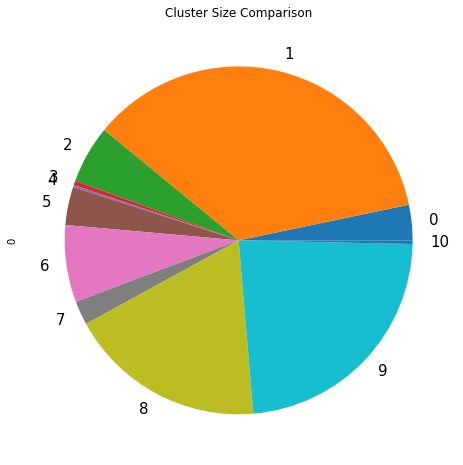

In [200]:
pd.DataFrame(count_chart).plot( kind="pie", y=0, figsize=(8,8),
                               title="Cluster Size Comparison",
                               fontsize=15,
                               label=None,legend=None)



### 4.4 Naming Clusters

Clusters are named with respect to statistical findings above. Population refers to vehicle population.

In [227]:
clusters = [
    "Low population, moderate competition. Extreme population growth.", #0
    "Very low population, car density and competiton. Slowly decreasing population.", #1
    "High population, very high car density but low competition.", #2
    "High and stable population, low competition, extreme car density.", #3
    "Very low competition, density and population, extremely fast declining population.", #4
    "Very low population and car density, rapidly declining population", #5
    "High population, moderate density but extreme competition.", #6
    "Very high population and density, high competition, slowly increasing population", #7
    "Low population, density and competition. Rapidly declining population.", #8
    "Moderate population, low car density. Rapidly increasing population.", #9
    "Extreme population and density, low competition. Very slowly decreasing population." #10
           ] 
cluster_header = pd.DataFrame({
    "Cluster Names" : clusters
}, index=[ np.arange( len(clusters) ) ]
)

print( "Cluster ID :\n", "---|"+"-"*70, sep="" )
for c in range( 0, cluster_header.shape[0] ):
    if c != 10:
        print( c, " : ", cluster_header.iloc[c].values[0] )
    else:
        print( c, ": ", cluster_header.iloc[c].values[0] )
print( "---|"+"-"*70 )

Cluster ID :
---|----------------------------------------------------------------------
0  :  Low population, moderate competition. Extreme population growth.
1  :  Very low population, car density and competiton. Slowly decreasing population.
2  :  High population, very high car density but low competition.
3  :  High and stable population, low competition, extreme car density.
4  :  Very low competition, density and population, extremely fast declining population.
5  :  Very low population and car density, rapidly declining population
6  :  High population, moderate density but extreme competition.
7  :  Very high population and density, high competition, slowly increasing population
8  :  Low population, density and competition. Rapidly declining population.
9  :  Moderate population, low car density. Rapidly increasing population.
10 :  Extreme population and density, low competition. Very slowly decreasin population
---|-------------------------------------------------------------

### 4.5 Mapping New Stations

Calculated optimal target locations are marked in a map by folium package. Map is centered manually, so as to make all targets. Spesific stations parent cluster is expressed in different colors and location interpretion can be seen by pop-ups which will show upon clicking.

In [247]:
#Map center
gas_map = folium.Map( location=[39.52021, 35.365718], zoom_start=6 )

#Label colors
x = np.arange(n_clusters)
ys = [i + x + (i*x)**2 for i in range(n_clusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

for l in range( 0, newStationData.shape[0] ):
    folium.CircleMarker(
        [newStationData.iloc[l]["Latitude"],newStationData.iloc[l]["Longitude"]],
        radius = 3,
        popup = cluster_header.iloc[ newStationData["Cluster ID"].iloc[l] ].values[0],
        fill = True,
        fill_opacity = 0.8,
        color = rainbow[ newStationData.iloc[l]["Cluster ID"] ],
        fill_color = rainbow[ newStationData.iloc[l]["Cluster ID"] ]
    ).add_to( gas_map )

gas_map

## 5. Conclusion

For a company which has no presence in Turkish market, invetsments on cluster 0 should be prioritized. In moderate competition and extreme population growth environment the company can easily make loyal customers and it is possible to expect a value increment of tangible assets in the long term.

Locations covered by cluster 1 are generally rural parts of Turkey. For escalated growth, large investments that will increase local employment rate, urbanization and overall gas cosumption like consturction activites of roads, bridges, industrial plants should be examined closely.

Areas having crowds, very high car density and low competition are covered by cluster 2. Low competition attribute indicates good investment opportunities but population growth rate has large variance within cluster 2. Therefore, it will be best to focus on targets that are having high population growth in cluster 2.

Investing on cluster 4 and 5 locations should be refrained due to rapidly shrinking population. Positive changes in population increase percentage or significant decreases in competition may make members of this cluster feasible.

When considering investing to members of cluster 6, approaches similar cluster 2 should be thought of. Population aspects may contribute to brand awareness and may yield large and stable cashflows to the facilities. But cluster 6 members are placed in more competitive environments, compared to as of cluster 2. Therefore traffic data has to be examined carefully and discounts of assets for initial invesment opportunities should be searched for higher return expectations.

For cluster 7, similiar to cluster 6 large and stable cashflows can be expected due to high population. It will be best to wait for market fluctions and obtaining assets at discounted prices. Otherwise, following and choosing districts that are expecting migration and population growth. When compared with cluster 6, investments to locations that are member of cluster 7 can be done more confidently due to less competition.

Investments to members of cluster 8 should be refrained at first, should be done at the later part of market expansion for brand awareness due to rapidly decreasing population.

For cluster 9, rapid population increase and moderate to low car density indicates good investment opportunities. Investments should be made by examining car population and rival station amount.

Cities with extreme population are present in cluster 10. Very large markets with relatively small competition is suspicious. Legal bases and asset prices in this group should be reviewed before desicion.